### Generating Images with GANs
- In this assignment, you will implement a Generative Adversarial Network (GAN), for the task of image generation. 
- You will train this model on Fashion-MNIST, a synthetic dataset including the grayscale images of shoes, clothes, hats, etc.
- We only provide abstract instructions.  You have the freedom to implement the model from scratch and customize helper functions for your convenience.
- We will primarily grade your work based on the quality of generated images by visualization.
- A GAN model usually needs long-term training to produce high quality images. If you need GPUs to accelerate your experiment, please consider using Google's colab which provides free GPU runtime.




In [35]:
# Kameel Khabaz
# CMSC 25040 Computer Vision Homework 4

"""
Import PyTorch libraries.
"""
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torchvision import datasets, transforms
from torchvision.utils import save_image
import torch.optim as optim
import numpy as np
import random
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [18]:
# Check GPU availability
assert torch.has_mps == True, "PyTorch not working on GPU"
device = torch.device("mps") # set GPU device

Ankle Boot


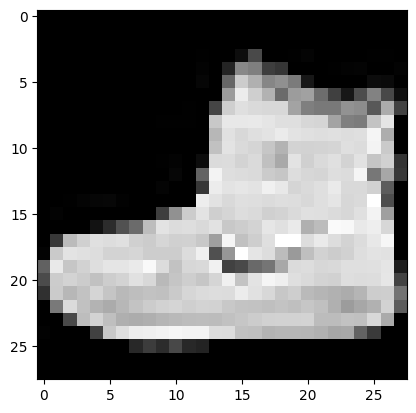

In [19]:
"""
Define the dataloader for the Fashion MNIST dataset.
"""
batch_size = 64
train_set = torchvision.datasets.FashionMNIST("./data", download=True, transform=
                                                transforms.Compose([transforms.ToTensor()]))
test_set = torchvision.datasets.FashionMNIST("./data", download=True, train=False, transform=
                                               transforms.Compose([transforms.ToTensor()])) 
train_loader = torch.utils.data.DataLoader(train_set, 
                                           batch_size=batch_size)
test_loader = torch.utils.data.DataLoader(test_set,
                                          batch_size=batch_size)
def output_label(label):
    output_mapping = {
                 0: "T-shirt/Top",
                 1: "Trouser",
                 2: "Pullover",
                 3: "Dress",
                 4: "Coat", 
                 5: "Sandal", 
                 6: "Shirt",
                 7: "Sneaker",
                 8: "Bag",
                 9: "Ankle Boot"
                 }
    input = (label.item() if type(label) == torch.Tensor else label)
    return output_mapping[input]
image, label = next(iter(train_set))
plt.imshow(image.squeeze(), cmap="gray")
print(output_label(label))

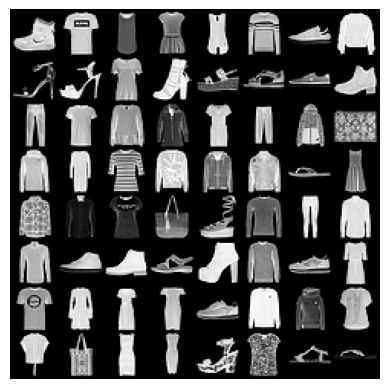

In [21]:
import torchvision.utils as vutils
plt.figure()
plt.axis("off")
images = next(iter(train_loader))
plt.imshow(np.transpose(vutils.make_grid(images[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))


Generative Adversarial Network (GAN)
- A GAN is a generation model trained to convert the samples from prior distribution $z$ to the target domains $x$, e.g., images or text, in an unsupervised fashion.
- A GAN consists of a generator (G) and discriminator (D) model, where $G$ is trained to produce realistic samples of the target domain, while the $D$ learns to identified the samples from generator and the real domain, and serve as the supervision to optimize the $G$.
- GAN training typically follows two iterative steps:
  1. $\max_D \log\left(D\left(x\right)\right) + \log\left(1 - D\left(G\left(z\right)\right)\right)$
  2.$\max_G \log\left(D\left(G\left(z\right)\right)\right)$

#### Define GAN Model (TODO) [20 points]
- Define the generator and discriminator for the GAN model

In [22]:

# custom weights initialization
def weights_init(m):
    classname = m.__class__.__name__
    if "Conv" in classname and "Block" not in classname:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif "BatchNorm" in classname:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class ConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch, kernel, stride, padding):
        super().__init__()

        layers = []
        # First layer downsamples, others do not 
        layers.append(nn.Conv2d(in_ch, out_ch, kernel, stride, padding, bias=False))
        layers.append(nn.BatchNorm2d(out_ch))
        layers.append(nn.LeakyReLU(negative_slope = 0.2, inplace=True))
        
        self.block = nn.Sequential(*layers)

    def forward(self, x):
        return self.block(x)

class Discriminator_Model(nn.Module):
    def __init__(self, img_channel, img_w, n_classes):
        # img_w: width of image in pixels
        # nconvblocks: # blocks of 2xconvolution + relu + pool in model
        super(Discriminator_Model, self).__init__()
 
        # input is (nc) x 28 x 28
        self.c1 = nn.Conv2d(img_channel, img_w, 4, 2, 1)
        self.r1 = nn.LeakyReLU(0.2, inplace=True)
        # state size. (ndf) x 14 x 14

        self.c2 = ConvBlock(img_w, img_w * 2, 4, 2, 1)
        # state size. (ndf*2) x 7 x 7

        self.c3 = ConvBlock(img_w * 2, img_w * 4, 3, 2, 1)
        # state size. (ndf*4) x 4 x 4

        self.c4 = nn.Conv2d(img_w * 4, img_w * 8, 4, 2, 1, bias=False)
        # state size. (ndf*8) x 2 x 2

        ### ------------------ ###
        # Split the network
        # Produce 1x1 image for real/fake plus a 1x10 for the class type 
        ### ------------------ ###
        self.c5 = nn.Conv2d(img_w * 8, 1, 2, 1, 0, bias=False)
        self.sigmoid = nn.Sigmoid() # range 0 to 1 for probability
        # state size: 1 x 1 x 1

        self.flat = nn.Flatten(start_dim=1)
        lin_size = img_w * 8 * 2 * 2
        self.project = nn.Linear(lin_size, n_classes)
        

    def forward(self, x):
        # forward pass
        x = self.c1(x)
        x = self.r1(x)
        x = self.c2(x)
        x = self.c3(x)
        x = self.c4(x)

        # Split the network
        x_rf = self.c5(x)
        x_rf = self.sigmoid(x_rf)

        x_c = self.flat(x)
        x_c = self.project(x_c)

        return x_rf, x_c


# Define generator (adapted from my segmentation code in hw3)
class DecoderBlock(nn.Module):
      def __init__(self, in_ch, out_ch, kernel_size, stride, padding):
            super().__init__()
            self.block = nn.Sequential(nn.ConvTranspose2d(in_ch, out_ch, kernel_size=kernel_size, stride=stride, padding=padding, bias = False), # convolve changing channels and upsampling
                                   nn.BatchNorm2d(out_ch), 
                                   nn.LeakyReLU(negative_slope = 0.2, inplace=True))
    
      def forward(self, x):
            return self.block(x)
    
class Generator_Model(nn.Module):
    def __init__(self, gen_in_size, im_size, num_ch):
        super(Generator_Model, self).__init__()    
        self.d1 = DecoderBlock(gen_in_size, im_size * 8,  2, 1, 0)
        # state size. (im_size*8) x 2 x 2

        self.d2 = DecoderBlock(im_size * 8, im_size * 4,  4, 2, 1)
        # state size. (im_size*4) x 4 x 4

        self.d3 = DecoderBlock(im_size * 4, im_size * 2,  3, 2, 1)
        # state size. (im_size*2) x 7 x 7

        self.d4 = DecoderBlock(im_size * 2, im_size,  4, 2, 1)
        # state size. (im_size) x 14 x 14

        self.convf = nn.ConvTranspose2d(im_size, num_ch, 4, 2, 1, bias=False)
        self.sig = nn.Sigmoid() # normalize image data
        # state size. (im_size) x 28 x 28


    def forward(self, x):
        x = self.d1(x)
        x = self.d2(x)
        x = self.d3(x)
        x = self.d4(x)
        x = self.convf(x)
        x = self.sig(x)
        return x



In [23]:

# Define labels for real vs fake images
real_img_label = 1
fake_img_label = 0

# Use a binary cross entropy loss (0/1) for real/fake 
rf_loss_criterion = nn.BCELoss()

# Use a cross entropy loss for class
c_loss_criterion = nn.CrossEntropyLoss()

# Generator input size (Random vector)
gen_in_size = 100

# Create batch of latent vectors to visualize generator progression
fixed_noise = torch.randn(64, gen_in_size, 1, 1, device=device)

# Get image sizes
img_channel = 1
img_w = train_set.data.shape[-2]
n_classes = len(train_set.classes)


#### Complete the Training Loop (TODO) [20 points]
- Implement the complete training loop for the GAN model.
- You can monitor the loss curve between generator and discriminator to tune the hyperparamters.
- The loss of generator and discriminator converge toward some non-zero values at the end.  The generator's loss is generally higher than discriminator's loss.

In [28]:
"""
Initialize Hyperparameters and model
"""
glr = 0.0002
dlr = 0.0002
beta1 = 0.5
num_epochs = 20

Gmodel = Generator_Model(gen_in_size, img_w, img_channel)

Goptim = optim.Adam(Gmodel.parameters(), glr, (beta1, 0.999))
Gmodel.apply(weights_init)
print(Gmodel)

Dmodel = Discriminator_Model(img_channel, img_w, n_classes)

Doptim = optim.Adam(Dmodel.parameters(), dlr, (beta1, 0.999))
Dmodel.apply(weights_init)
print(Dmodel)


Generator_Model(
  (d1): DecoderBlock(
    (block): Sequential(
      (0): ConvTranspose2d(100, 224, kernel_size=(2, 2), stride=(1, 1), bias=False)
      (1): BatchNorm2d(224, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (d2): DecoderBlock(
    (block): Sequential(
      (0): ConvTranspose2d(224, 112, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(112, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (d3): DecoderBlock(
    (block): Sequential(
      (0): ConvTranspose2d(112, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (d4): DecoderBlock(
    (block): Sequential(
      (0): ConvTranspose2d(56, 28, kernel_

Epoch [0/20] Sample [0/938]	Loss_D: 6.1653	Loss_G: 3.2480	D(x): 0.4466	D(G(z)): 0.4428 / 0.3601
Epoch [0/20] Sample [50/938]	Loss_D: 3.2495	Loss_G: 7.1237	D(x): 0.9848	D(G(z)): 0.0152 / 0.0086
Epoch [0/20] Sample [100/938]	Loss_D: 2.9699	Loss_G: 8.1083	D(x): 0.9952	D(G(z)): 0.0037 / 0.0028
Epoch [0/20] Sample [150/938]	Loss_D: 3.0412	Loss_G: 7.8721	D(x): 0.9818	D(G(z)): 0.0028 / 0.0037
Epoch [0/20] Sample [200/938]	Loss_D: 2.7573	Loss_G: 8.6371	D(x): 0.9917	D(G(z)): 0.0012 / 0.0019
Epoch [0/20] Sample [250/938]	Loss_D: 3.1292	Loss_G: 7.2783	D(x): 0.9852	D(G(z)): 0.0288 / 0.0073
Epoch [0/20] Sample [300/938]	Loss_D: 3.0090	Loss_G: 7.7017	D(x): 0.9857	D(G(z)): 0.0088 / 0.0045
Epoch [0/20] Sample [350/938]	Loss_D: 2.8438	Loss_G: 8.4817	D(x): 0.9548	D(G(z)): 0.0006 / 0.0021
Epoch [0/20] Sample [400/938]	Loss_D: 3.1103	Loss_G: 6.3550	D(x): 0.9397	D(G(z)): 0.0334 / 0.0252
Epoch [0/20] Sample [450/938]	Loss_D: 3.1925	Loss_G: 6.6516	D(x): 0.9931	D(G(z)): 0.0924 / 0.0193
Epoch [0/20] Sample [50

/var/folders/p8/gbhwzvqj3dng1831pl4pc51r0000gq/T/ipykernel_56472/3347009255.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


Epoch [10/20] Sample [650/938]	Loss_D: 4.7941	Loss_G: 3.2532	D(x): 0.3114	D(G(z)): 0.0691 / 0.5801
Epoch [10/20] Sample [700/938]	Loss_D: 4.0232	Loss_G: 3.8620	D(x): 0.5712	D(G(z)): 0.0630 / 0.3307
Epoch [10/20] Sample [750/938]	Loss_D: 3.7966	Loss_G: 5.1846	D(x): 0.8331	D(G(z)): 0.2612 / 0.0923
Epoch [10/20] Sample [800/938]	Loss_D: 4.3352	Loss_G: 4.9179	D(x): 0.8009	D(G(z)): 0.4867 / 0.1294
Epoch [10/20] Sample [850/938]	Loss_D: 4.1052	Loss_G: 3.7913	D(x): 0.6260	D(G(z)): 0.1884 / 0.3605
Epoch [10/20] Sample [900/938]	Loss_D: 3.9842	Loss_G: 4.8667	D(x): 0.7496	D(G(z)): 0.3379 / 0.1483
Epoch [11/20] Sample [0/938]	Loss_D: 3.9242	Loss_G: 3.6328	D(x): 0.6088	D(G(z)): 0.2262 / 0.4001
Epoch [11/20] Sample [50/938]	Loss_D: 4.1743	Loss_G: 4.1124	D(x): 0.5762	D(G(z)): 0.1594 / 0.2750
Epoch [11/20] Sample [100/938]	Loss_D: 3.8757	Loss_G: 4.9450	D(x): 0.7439	D(G(z)): 0.2134 / 0.1336
Epoch [11/20] Sample [150/938]	Loss_D: 3.9206	Loss_G: 4.0550	D(x): 0.5915	D(G(z)): 0.1222 / 0.2776
Epoch [11/20]

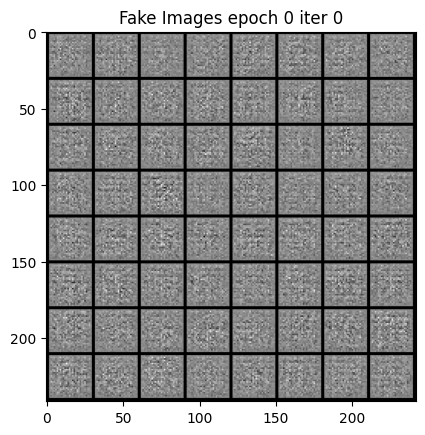

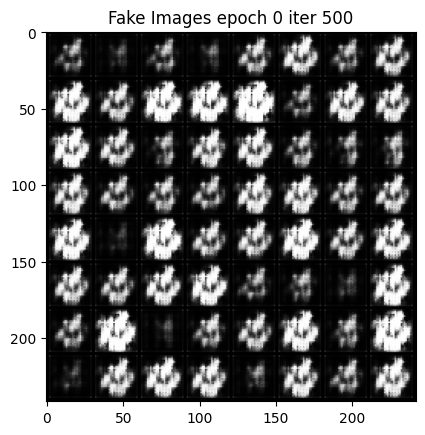

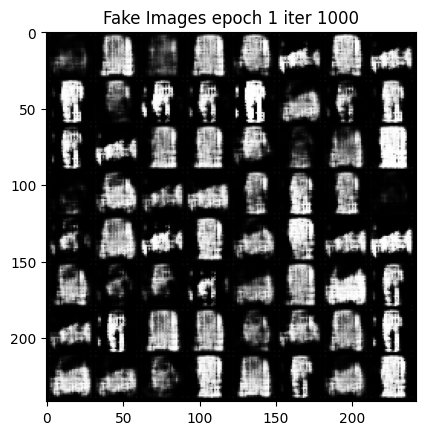

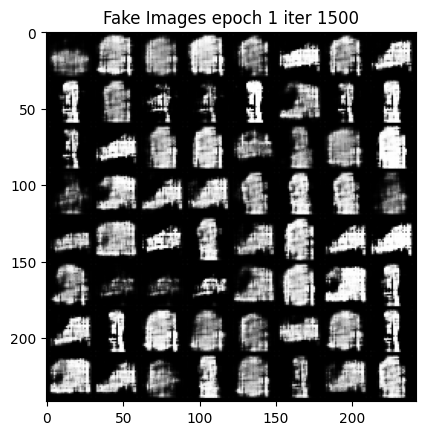

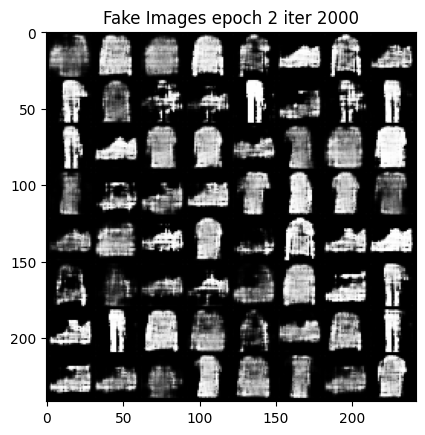

...

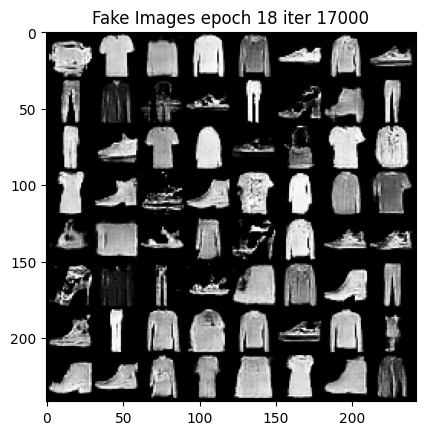

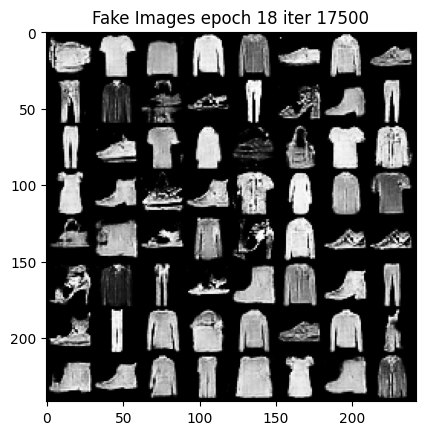

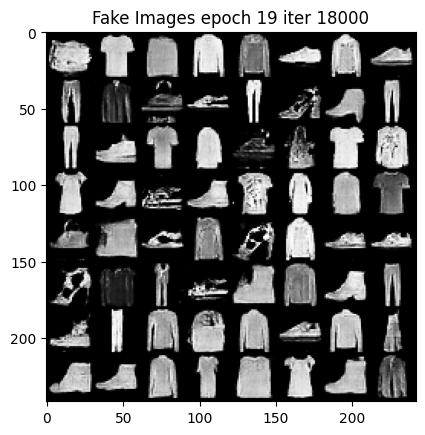

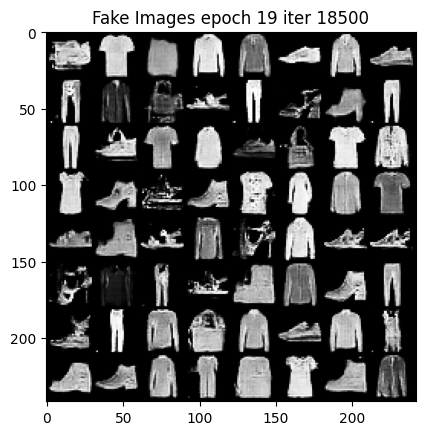

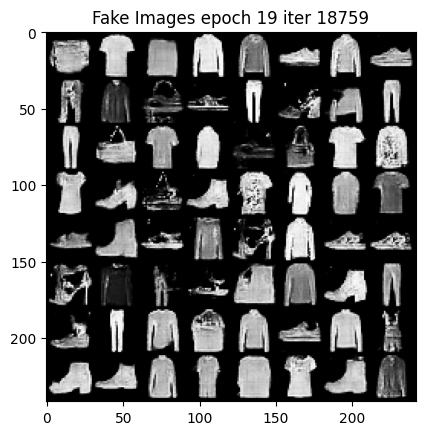

In [27]:

def train(loader_train, Dmodel, Gmodel, Doptim, Goptim, device, fixed_noise, epochs=100):
    Dmodel = Dmodel.to(device)
    Gmodel = Gmodel.to(device)
    img_list = []
    G_losses = []
    D_losses = []
    iters = 0

    for e in range(epochs):
        for t, (real_x, real_c) in enumerate(loader_train):
            ### ----------------------------------------- ###
            # Update the discriminator (maximize log(D(x)) + log(1 - D(G(z)))
            ### ----------------------------------------- ###

            Dmodel.zero_grad()
            # move data to GPU 
            real_x = real_x.to(device) # real images
            real_c = real_c.to(device) # real class labels

            batch_size = real_x.size(0)
            label_rf = torch.full((batch_size,), real_img_label, dtype = torch.float, device = device)

            # Forward pass for real images (maximize log(D(x)))
            real_discrim_output_rf, real_discrim_output_c = Dmodel(real_x)
            real_discrim_output_rf = real_discrim_output_rf.view(-1)
            # Calc discriminator loss on real image batch
            lossD_real_img_rf = rf_loss_criterion(real_discrim_output_rf, label_rf)
            lossD_real_img_c = c_loss_criterion(real_discrim_output_c, real_c)
            lossD_real_img = lossD_real_img_rf + lossD_real_img_c
            # Now calculate gradients using a backwards pass
            lossD_real_img.backward()
            D_x = real_discrim_output_rf.mean().item()

            # Make fake image using Generator
            noise = torch.randn(batch_size, gen_in_size, 1, 1, device = device)
            fake_images = Gmodel(noise)
            label_rf.fill_(fake_img_label)
            fake_c = torch.randint(low = 0, high = 10, size = (batch_size,),  device = device) # uniform dist [0,9]

            # Forward pass for fake images (maximize log(1 - D(G(z)))
            # Classify the fake images 
            fake_discrim_output1_rf, fake_discrim_output1_c = Dmodel(fake_images.detach())
            fake_discrim_output1_rf = fake_discrim_output1_rf.view(-1)
            # Calculate D(G(z)) (loss of discriminator on fake images)
            lossD_fake_img_rf = rf_loss_criterion(fake_discrim_output1_rf, label_rf)
            lossD_fake_img_c =  c_loss_criterion(fake_discrim_output1_c, fake_c)
            # Now calculate gradients using a backwards pass
            lossD_fake_img = lossD_fake_img_rf + lossD_fake_img_c
            lossD_fake_img.backward()

            # Compute total discriminator loss
            lossD = lossD_real_img + lossD_fake_img
            Doptim.step() # update discriminator 

            ### ----------------------------------------- ###
            # Update generator network to maximize (log(D(G(z))), equivalent to minimizing log(1−D(G(z)))
            ### ----------------------------------------- ###
            Gmodel.zero_grad()
            label_rf.fill_(real_img_label) # generator cost 
            
            # Calculate D(G(z)) after D is updated
            fake_discrim_output2_rf, fake_discrim_output2_c = Dmodel(fake_images)
            fake_discrim_output2_rf = fake_discrim_output2_rf.view(-1)
            lossG_rf = rf_loss_criterion(fake_discrim_output2_rf, label_rf)
            lossG_c  = c_loss_criterion(fake_discrim_output2_c, fake_c)
            lossG = lossG_rf + lossG_c
            # Calculate generator gradients
            lossG.backward()
            Goptim.step() # update generator 


            # Output training stats
            if t % 50 == 0:
                print('Epoch [%d/%d] Sample [%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                    % (e, num_epochs, t, len(loader_train),
                        lossD.item(), lossG.item(), D_x, fake_discrim_output1_rf.mean().item(), fake_discrim_output2_rf.mean().item()))

        
            # Track losses
            G_losses.append(lossG.item())
            D_losses.append(lossD.item())

            # Check how the generator is doing by saving G's output on fixed_noise
            if (iters % 500 == 0) or ((e == num_epochs-1) and (t == len(train_loader)-1)):
                with torch.no_grad():
                    fake = Gmodel(fixed_noise).detach().cpu()

                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

                # Plot image     
                plt.figure()
                plt.imshow(np.transpose(img_list[-1],(1,2,0)))
                plt.title("Fake Images epoch {} iter {}".format(e, iters))
                

            iters += 1
    
    return img_list, G_losses, D_losses


img_list, G_losses, D_losses = train(train_loader, Dmodel, Gmodel, Doptim, Goptim, device, fixed_noise, num_epochs)

In [29]:

# Grab a batch of real images from the dataloader
real_batch = next(iter(train_loader))

# Save model and images
torch.save(img_list, "img_list_class")
torch.save(G_losses, "G_losses_class")
torch.save(D_losses, "D_losses_class")

torch.save(Gmodel.state_dict(),"Gmodel_class.pt")
torch.save(Dmodel.state_dict(),"Dmodel_class.pt")
torch.onnx.export(Gmodel.cpu(), fixed_noise.cpu(), "Gmodel_class.onnx", input_names=["Input noise vector"], output_names=["Generated Image"])
torch.onnx.export(Dmodel.cpu(), real_batch[0].cpu(), "Dmodel_class.onnx", input_names=["Input image"], output_names=["Classification (Real/Fake and Class)"])

========== Diagnostic Run torch.onnx.export version 2.0.0.dev20230118 ==========
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================

========== Diagnostic Run torch.onnx.export version 2.0.0.dev20230118 ==========
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



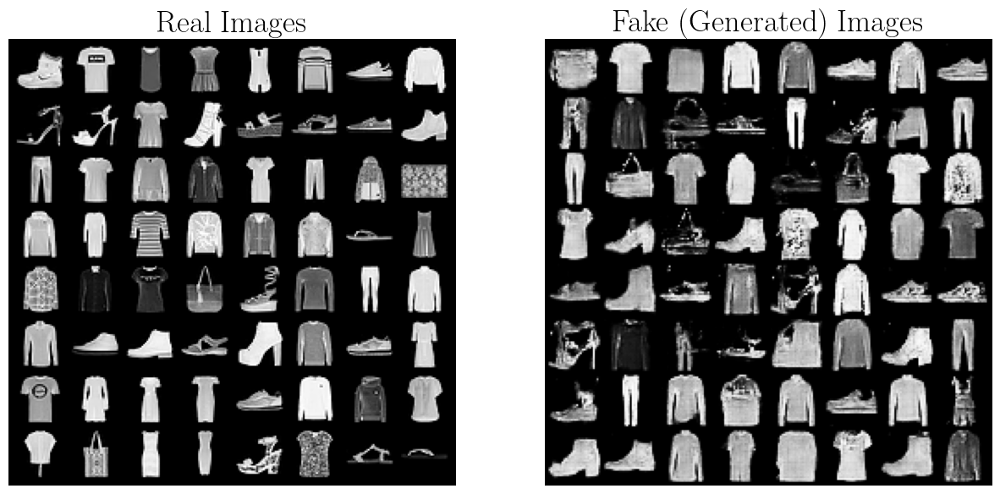

In [39]:
# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))
# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake (Generated) Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

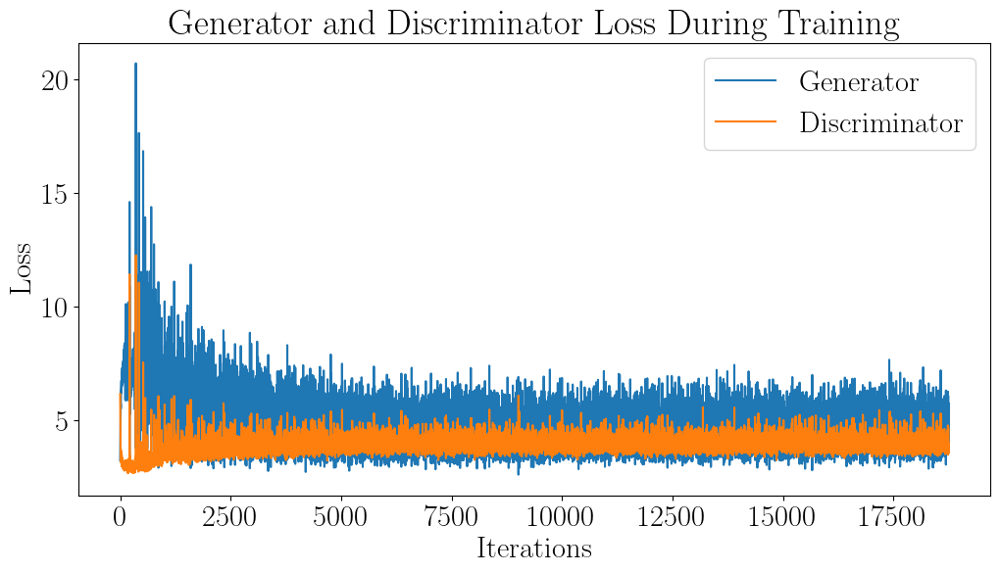

In [37]:
from matplotlib import rc
import matplotlib.pylab as plt

rc('font', **{'family': 'serif', 'serif': ['Computer Modern'],'size': 22})
rc('text', usetex=True)

plt.figure(figsize=(12,6))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="Generator")
plt.plot(D_losses,label="Discriminator")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


#### Visualizing the output
- Display the GAN output by running multiple samples of the latent space.
- Modify this function accordingly to fit your implementation.  The included code snippet simply renders a set of fake images (GAN output).

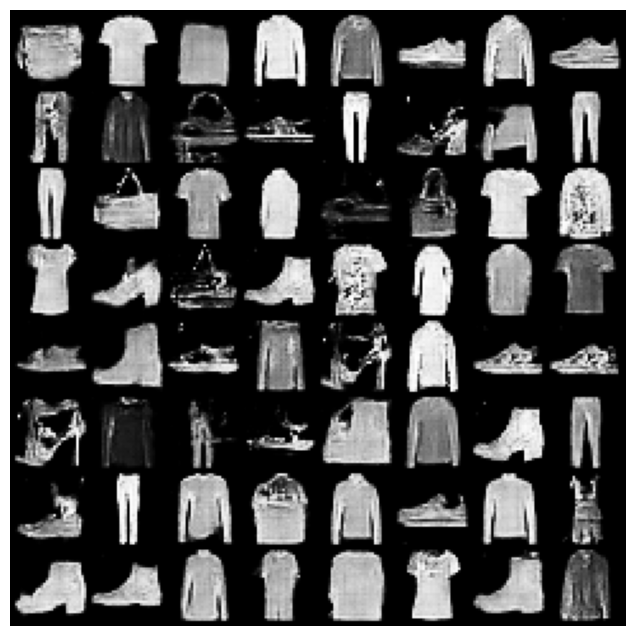

In [33]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())